# Thief Detector
## This task tests your Image Processing skills to build a motion detection algorithm that alarms you when you have an unwanted visitor in your home.

## Steps
- 1. Get the live video feed from your webcam
- 2. Fix a scene (the place you want to monitor) and store it as a reference background image
    - Store the first frame as the reference background frame
- 3. For every frame, check if there is any unwanted object inside the scene you are monitoring
    - Use **Background Subtraction** concept (**cv2.absdiff( )**)
        - Subtract the current frame from the reference background image(frame) to see the changes in the scene
        - If there is enormous amount of pixels distrubed in the subtraction result image
            - unwanted visitor (place is unsafe --> alarm the authorities)
        - If there is no enormous amount of pixels distrubed in the subtraction result image
            - no unwanted visitor (place is safe)
- 4. Output the text **"UNSAFE"** in **red** color on the top right of the frame when there is an intruder in the scene.
- 5. Save the live feed
- 6. Submit the (.ipynb) file

## Get live video feed from webcam [10 points]

In [13]:
# !pip install opencv-python
import cv2
from matplotlib import pyplot as plt

In [14]:
cap = cv2.VideoCapture(0)

[ WARN:0@230.807] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_f6tvh9615u/croot/opencv-suite_1691620375715/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created


## Read first frame, convert to Grayscale and store it as reference background image [10 points]

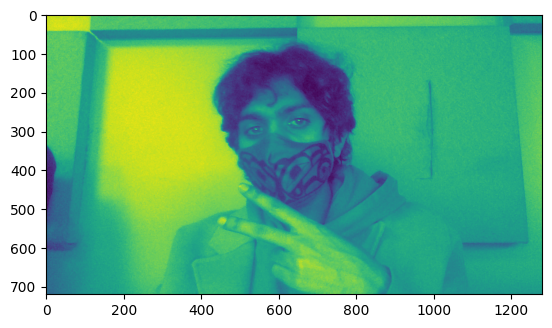

In [15]:
ret, frame = cap.read()
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
plt.imshow(gray)

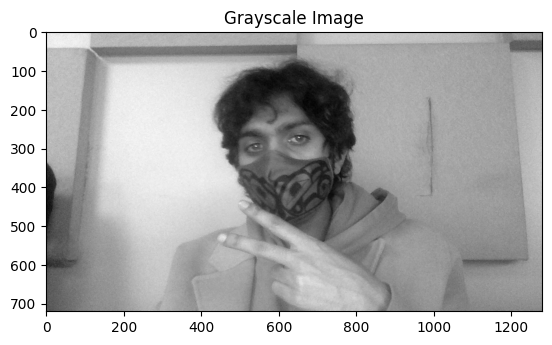

In [16]:
# Display the grayscale image using matplotlib
plt.imshow(gray, cmap='gray')
plt.title('Grayscale Image')
plt.show()

# Release the camera
cap.release()

## Compute Absolute Difference between Current and First frame [20 points]

[ WARN:0@455.686] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_f6tvh9615u/croot/opencv-suite_1691620375715/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created


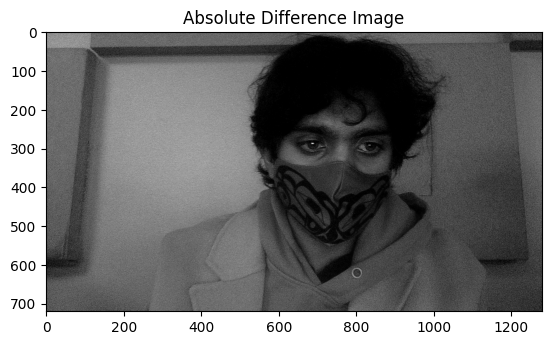

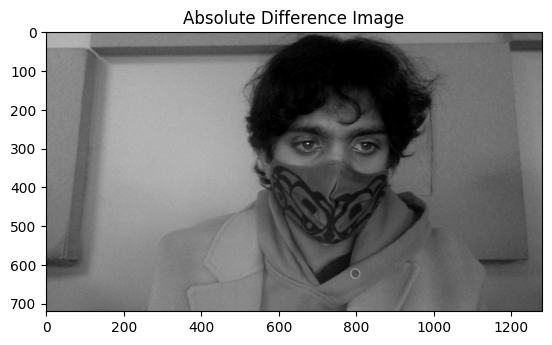

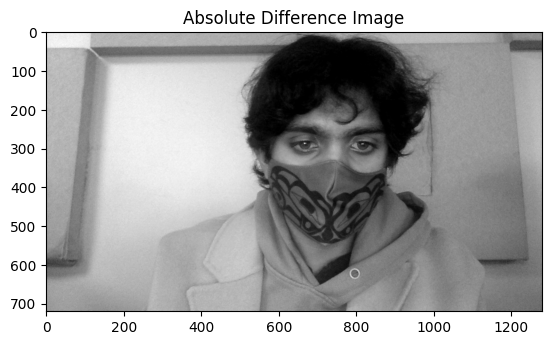

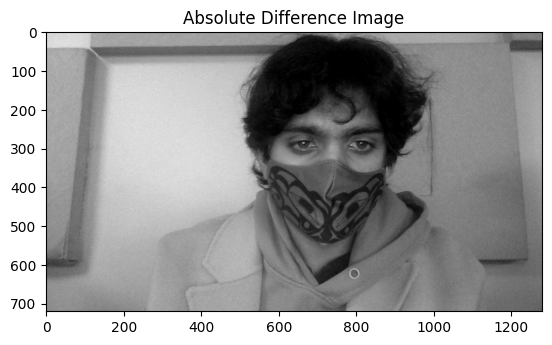

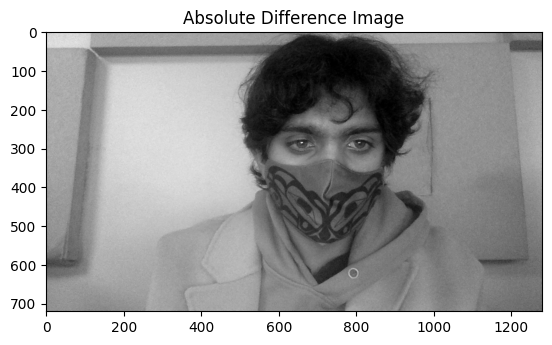

...

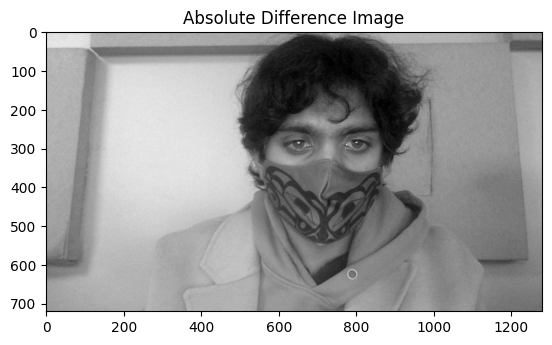

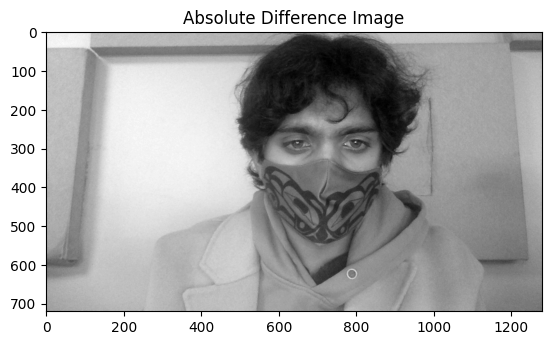

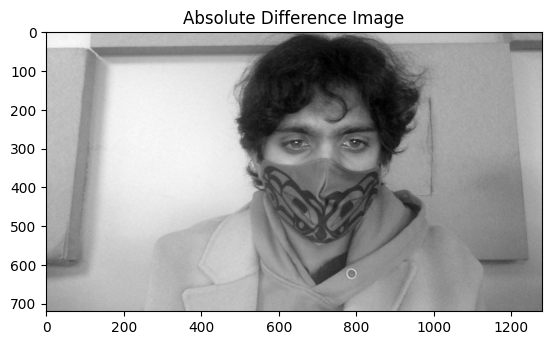

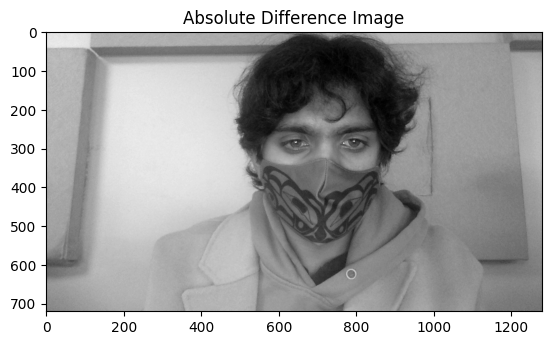

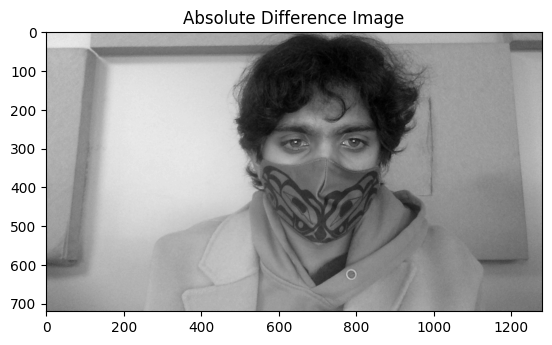

In [20]:
import cv2
import matplotlib.pyplot as plt
import time

# Assume cap is your VideoCapture object
cap = cv2.VideoCapture(0)

# Check if the camera is opened successfully
if not cap.isOpened():
    print("Error: Couldn't open the webcam.")
else:
    # Read the first frame from the camera
    ret, first_frame = cap.read()

    # Convert the first frame to grayscale
    first_frame_gray = cv2.cvtColor(first_frame, cv2.COLOR_BGR2GRAY)

    # Get the start time
    start_time = time.time()

    # Loop for capturing and processing frames for 3 seconds
    while (time.time() - start_time) < 5:
        # Read the current frame from the camera
        ret, frame = cap.read()

        if not ret:
            print("Error: Couldn't read a frame from the camera.")
            break

        # Convert the current frame to grayscale
        current_frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Compute the absolute difference between the current and first frame
        abs_diff = cv2.absdiff(current_frame_gray, first_frame_gray)

        # Display the absolute difference image using matplotlib
        plt.imshow(abs_diff, cmap='gray')
        plt.title('Absolute Difference Image')
        plt.show()

        # Press 'q' to exit the loop and release the camera
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the camera
    cap.release()

# Close all OpenCV windows
cv2.destroyAllWindows()

## Apply threshold [5 points]

[ WARN:0@586.588] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_f6tvh9615u/croot/opencv-suite_1691620375715/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created


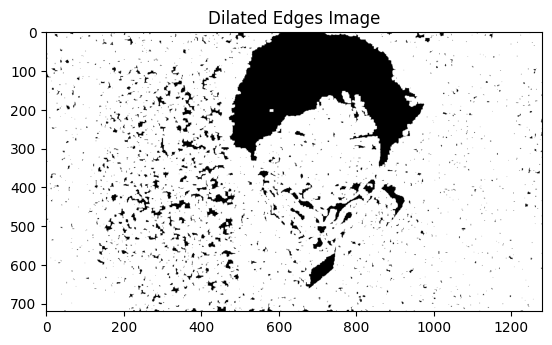

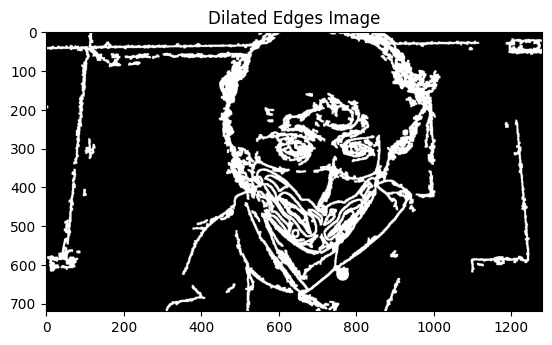

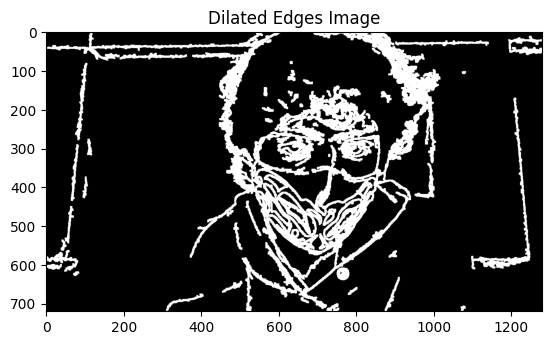

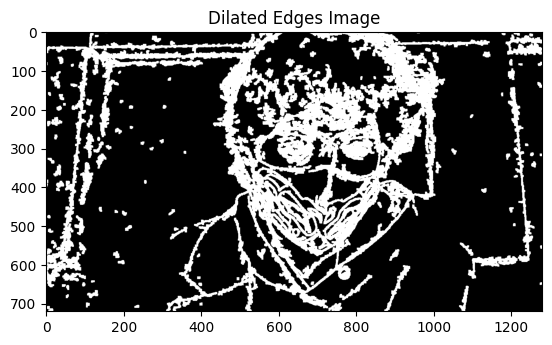

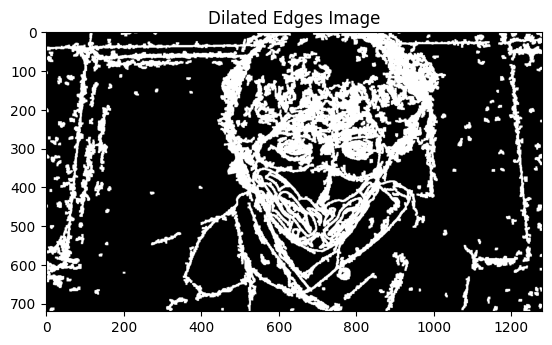

...

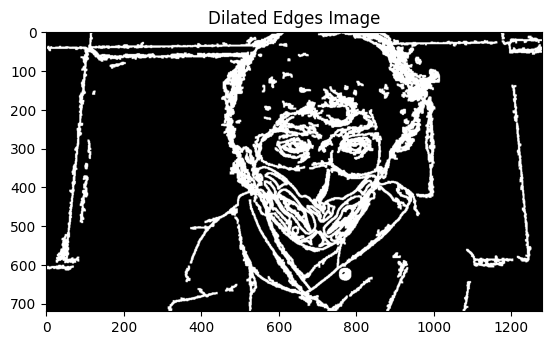

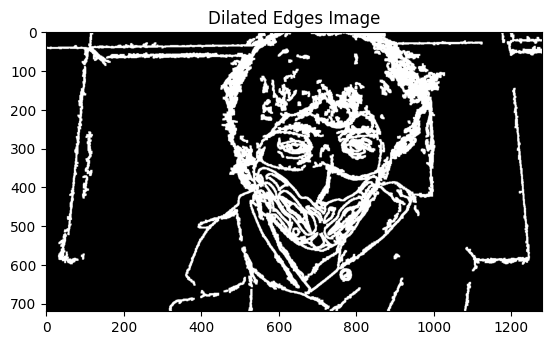

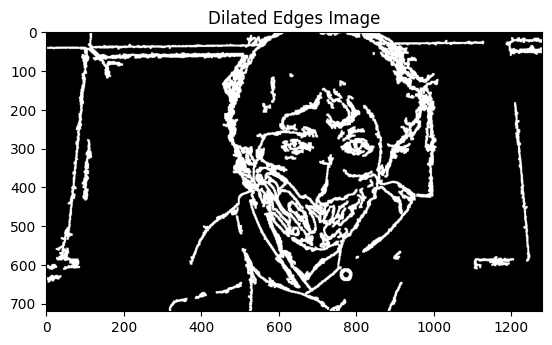

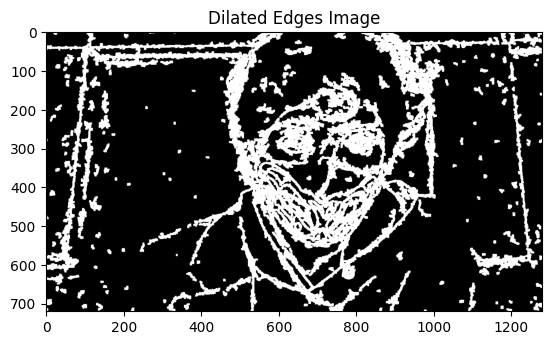

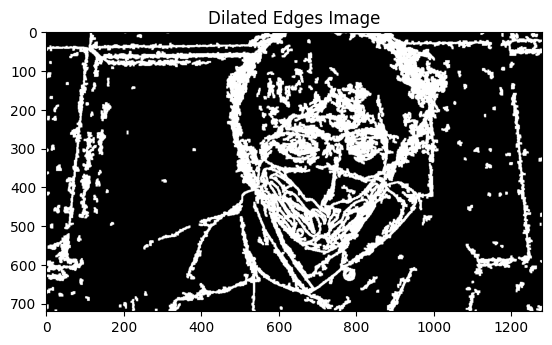

In [22]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import time

# Assume cap is your VideoCapture object
cap = cv2.VideoCapture(0)

# Check if the camera is opened successfully
if not cap.isOpened():
    print("Error: Couldn't open the webcam.")
else:
    # Read the first frame from the camera
    ret, first_frame = cap.read()

    # Convert the first frame to grayscale
    first_frame_gray = cv2.cvtColor(first_frame, cv2.COLOR_BGR2GRAY)

    # Get the start time
    start_time = time.time()

    # Loop for capturing and processing frames for 5 seconds
    while (time.time() - start_time) < 5:
        # Read the current frame from the camera
        ret, frame = cap.read()

        if not ret:
            print("Error: Couldn't read a frame from the camera.")
            break

        # Convert the current frame to grayscale
        current_frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Compute the absolute difference between the current and first frame
        abs_diff = cv2.absdiff(current_frame_gray, first_frame_gray)

        # Apply Canny edge detector
        edges = cv2.Canny(abs_diff, 30, 100)

        # Apply dilation to enhance edges
        kernel = np.ones((5, 5), np.uint8)
        dilated_edges = cv2.dilate(edges, kernel, iterations=1)

        # Display the dilated edges using matplotlib
        plt.imshow(dilated_edges, cmap='gray')
        plt.title('Dilated Edges Image')
        plt.show()

        # Press 'q' to exit the loop and release the camera
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the camera
    cap.release()

# Close all OpenCV windows
cv2.destroyAllWindows()

## Find contours [10 points]

[ WARN:0@681.414] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_f6tvh9615u/croot/opencv-suite_1691620375715/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created


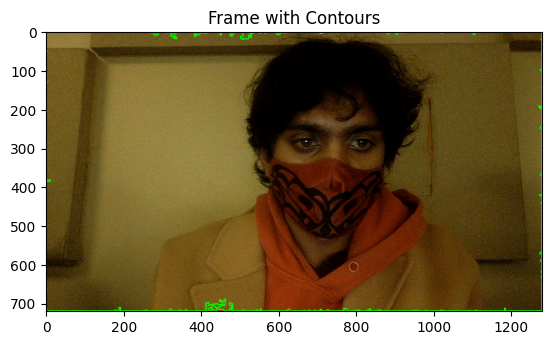

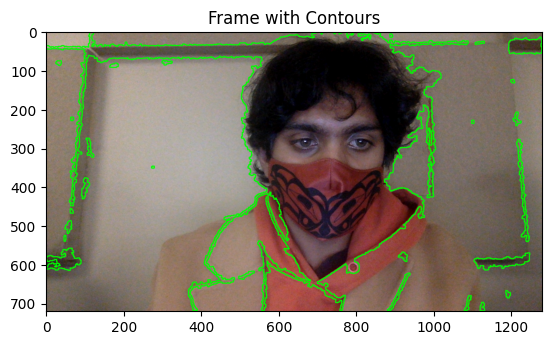

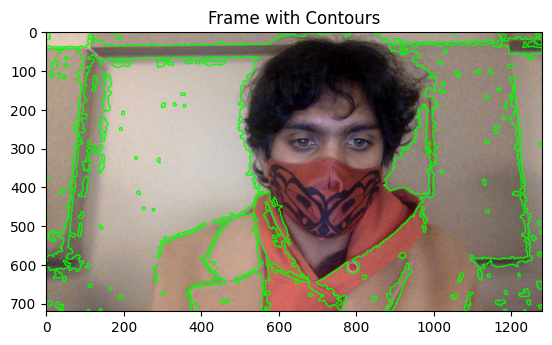

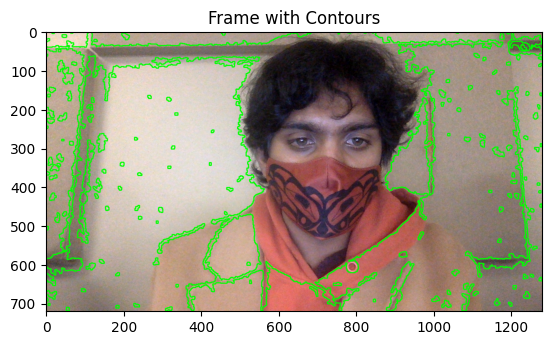

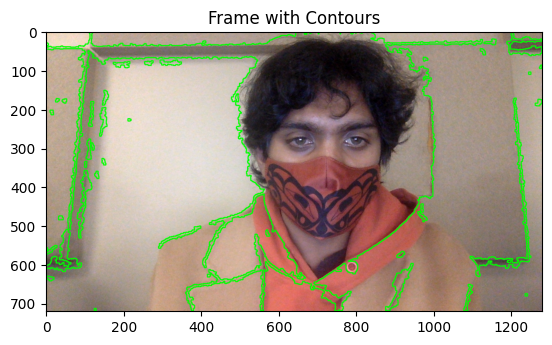

...

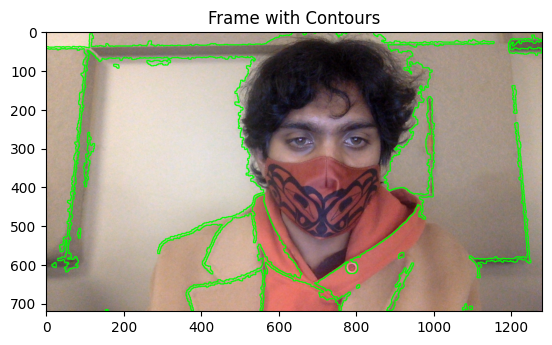

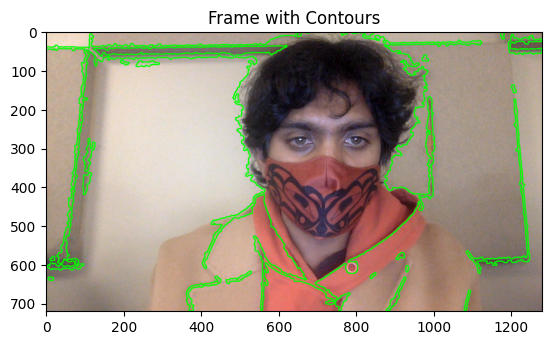

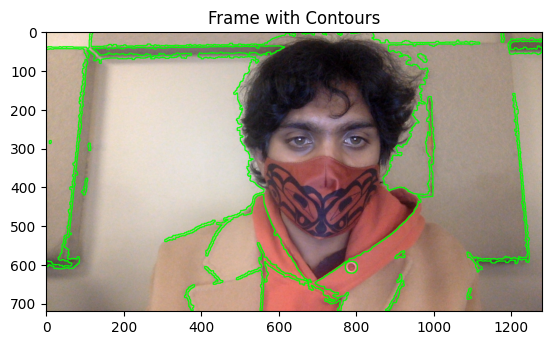

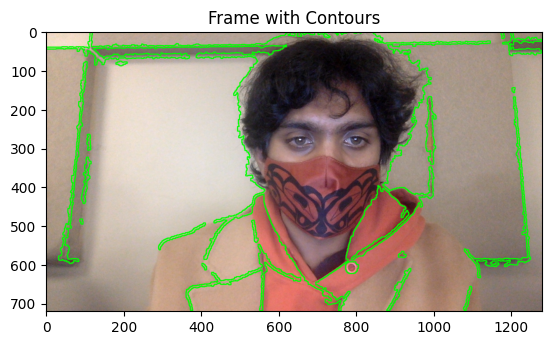

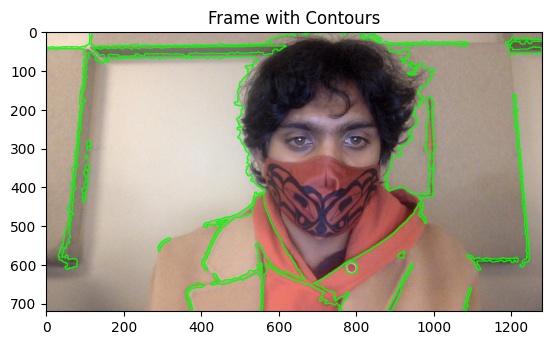

In [23]:
# Assume cap is your VideoCapture object
cap = cv2.VideoCapture(0)

# Check if the camera is opened successfully
if not cap.isOpened():
    print("Error: Couldn't open the webcam.")
else:
    # Read the first frame from the camera
    ret, first_frame = cap.read()

    # Convert the first frame to grayscale
    first_frame_gray = cv2.cvtColor(first_frame, cv2.COLOR_BGR2GRAY)

    # Get the start time
    start_time = time.time()

    # Loop for capturing and processing frames for 5 seconds
    while (time.time() - start_time) < 5:
        # Read the current frame from the camera
        ret, frame = cap.read()

        if not ret:
            print("Error: Couldn't read a frame from the camera.")
            break

        # Convert the current frame to grayscale
        current_frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Compute the absolute difference between the current and first frame
        abs_diff = cv2.absdiff(current_frame_gray, first_frame_gray)

        # Apply Canny edge detector
        edges = cv2.Canny(abs_diff, 30, 100)

        # Apply dilation to enhance edges
        kernel = np.ones((5, 5), np.uint8)
        dilated_edges = cv2.dilate(edges, kernel, iterations=1)

        # Find contours in the dilated edges image
        contours, _ = cv2.findContours(dilated_edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original frame
        frame_with_contours = frame.copy()
        cv2.drawContours(frame_with_contours, contours, -1, (0, 255, 0), 2)

        # Display the frame with contours using matplotlib
        plt.imshow(cv2.cvtColor(frame_with_contours, cv2.COLOR_BGR2RGB))
        plt.title('Frame with Contours')
        plt.show()

        # Press 'q' to exit the loop and release the camera
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the camera
    cap.release()

# Close all OpenCV windows
cv2.destroyAllWindows()

## Check if contourArea is large and draw rectangle around the object, output "UNSAFE" text in red color [30 points]

[ WARN:0@1075.957] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_f6tvh9615u/croot/opencv-suite_1691620375715/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created


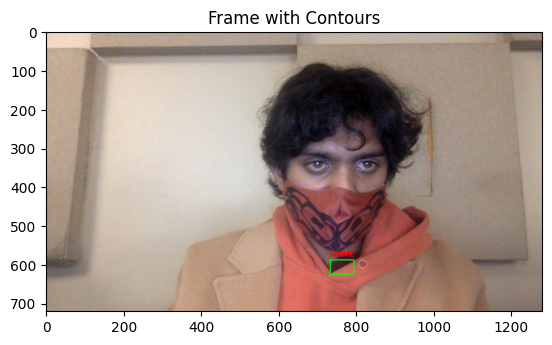

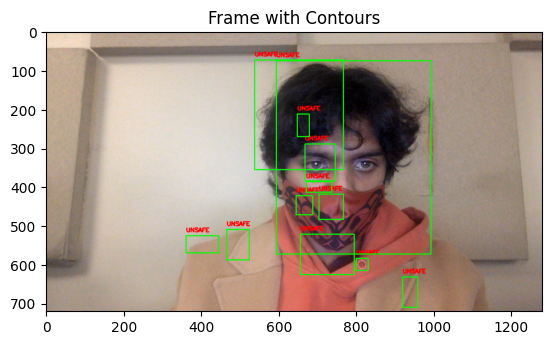

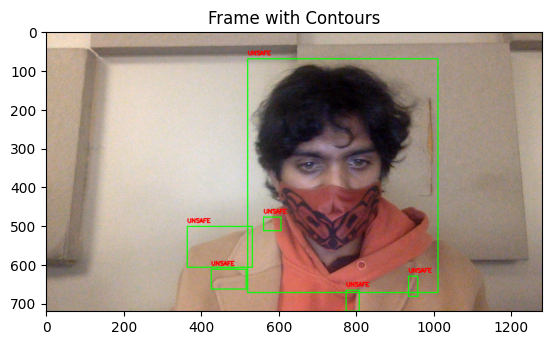

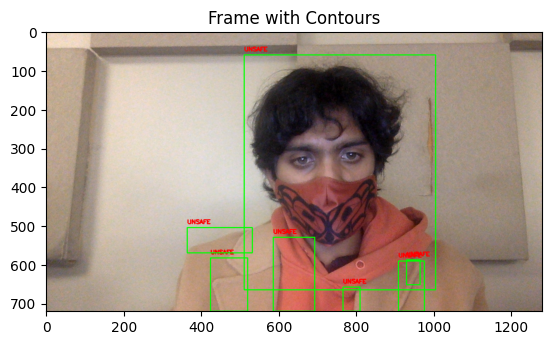

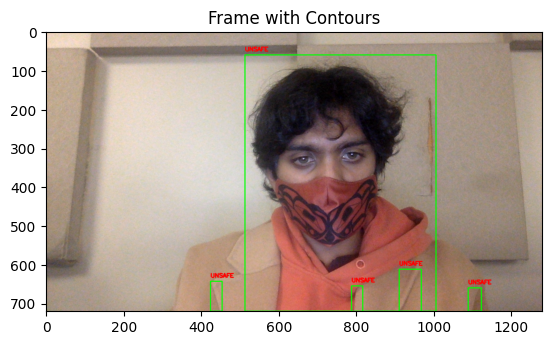

...

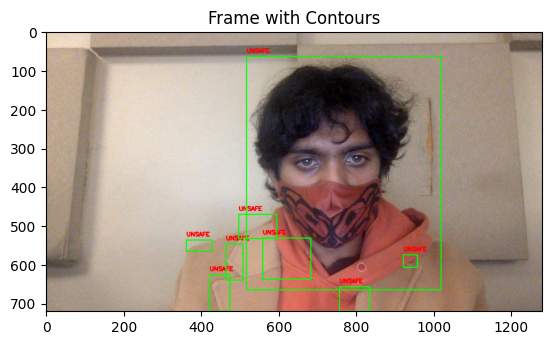

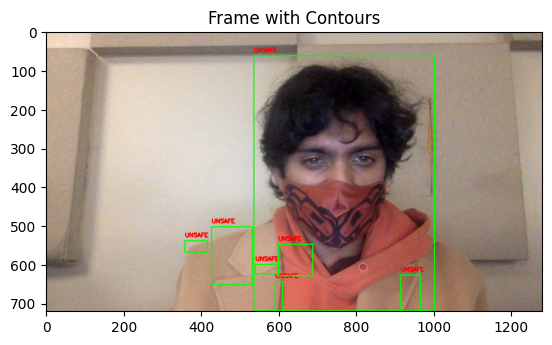

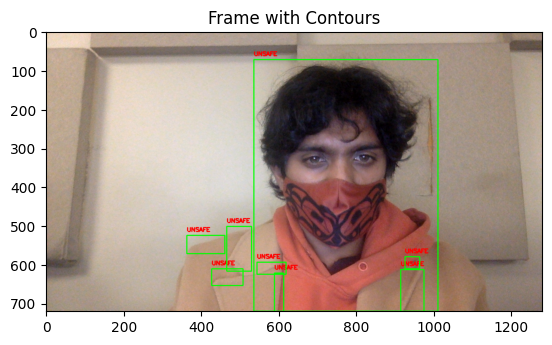

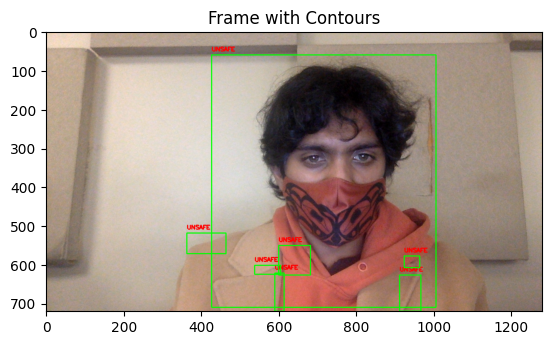

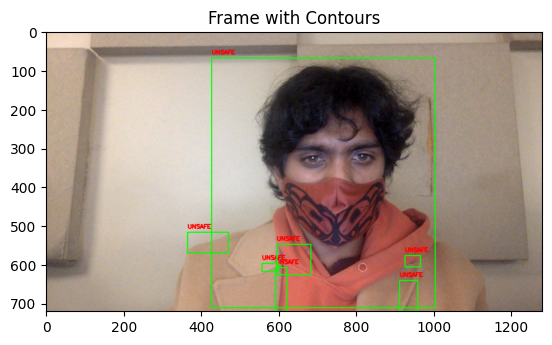

In [32]:
# Assume cap is your VideoCapture object
cap = cv2.VideoCapture(0)

# Check if the camera is opened successfully
if not cap.isOpened():
    print("Error: Couldn't open the webcam.")
else:
    # Read the first frame from the camera
    ret, first_frame = cap.read()

    # Convert the first frame to grayscale
    first_frame_gray = cv2.cvtColor(first_frame, cv2.COLOR_BGR2GRAY)

    # Get the start time
    start_time = time.time()

    # Loop for capturing and processing frames for 10 seconds
    while (time.time() - start_time) < 10:
        # Read the current frame from the camera
        ret, frame = cap.read()

        if not ret:
            print("Error: Couldn't read a frame from the camera.")
            break

        # Convert the current frame to grayscale
        current_frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Compute the absolute difference between the current and first frame
        abs_diff = cv2.absdiff(current_frame_gray, first_frame_gray)

        # Apply Canny edge detector
        edges = cv2.Canny(abs_diff, 30, 100)

        # Apply dilation to enhance edges
        kernel = np.ones((5, 5), np.uint8)
        dilated_edges = cv2.dilate(edges, kernel, iterations=1)

        # Find contours in the dilated edges image
        contours, _ = cv2.findContours(dilated_edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the original frame
        frame_with_contours = frame.copy()
        
        for contour in contours:
            # Check if contour area is large
            if cv2.contourArea(contour) > 500:
                # Draw a rectangle around the object
                x, y, w, h = cv2.boundingRect(contour)
                cv2.rectangle(frame_with_contours, (x, y), (x + w, y + h), (0, 255, 0), 2)
                
                # Output "UNSAFE" text in red color
                cv2.putText(frame_with_contours, 'UNSAFE', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

        # Display the frame with contours using matplotlib
        plt.imshow(cv2.cvtColor(frame_with_contours, cv2.COLOR_BGR2RGB))
        plt.title('Frame with Contours')
        plt.show()

        # Press 'q' to exit the loop and release the camera
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the camera
    cap.release()

# Close all OpenCV windows
cv2.destroyAllWindows()

[ WARN:0@4694.977] global /private/var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_f6tvh9615u/croot/opencv-suite_1691620375715/work/modules/videoio/src/cap_gstreamer.cpp (862) isPipelinePlaying OpenCV | GStreamer warning: GStreamer: pipeline have not been created


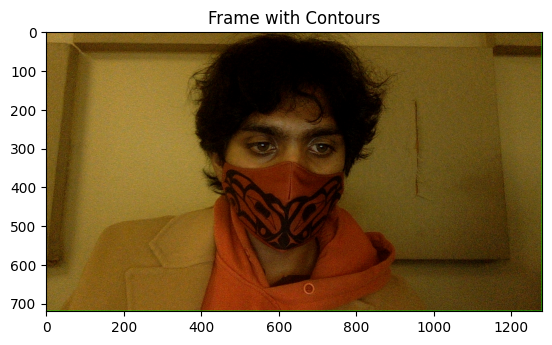

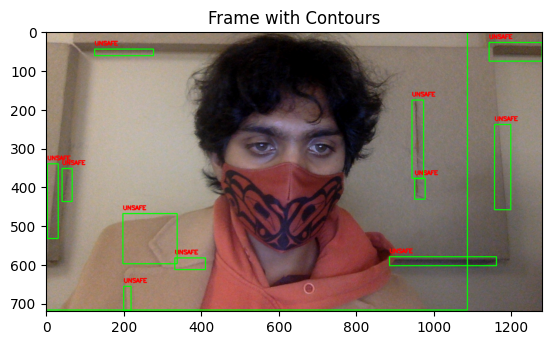

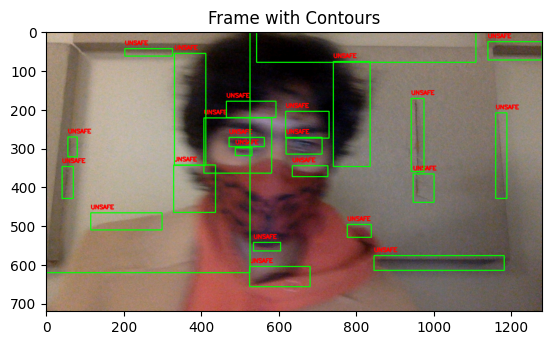

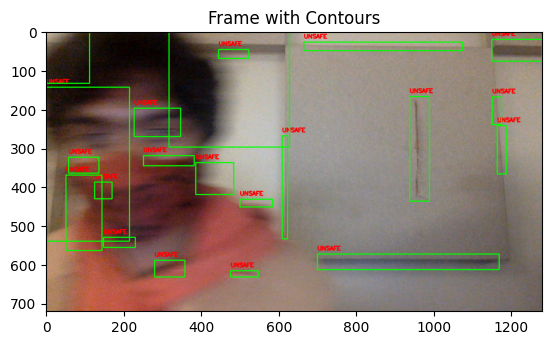

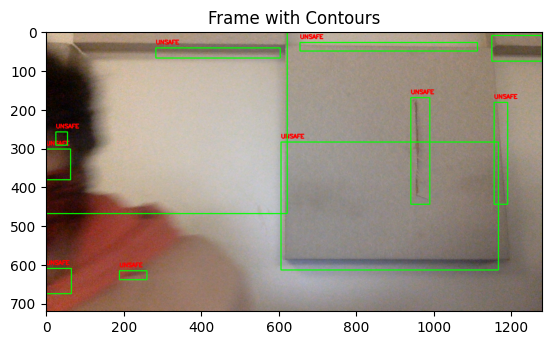

...

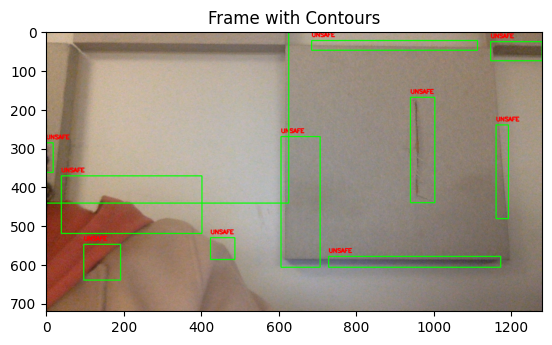

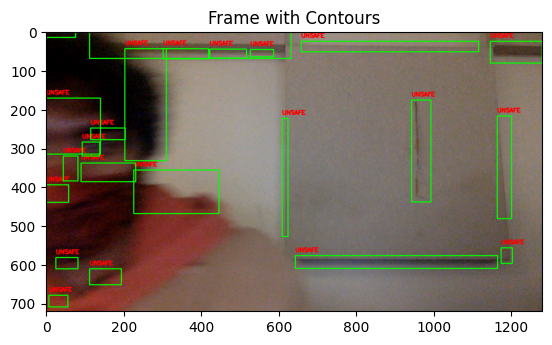

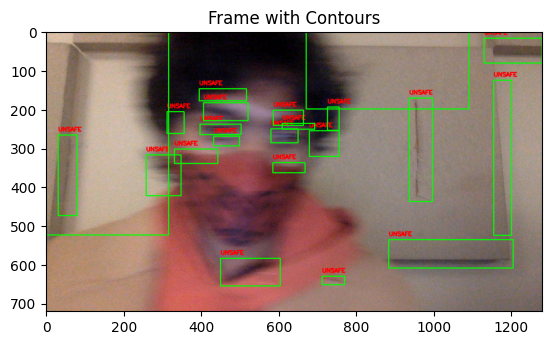

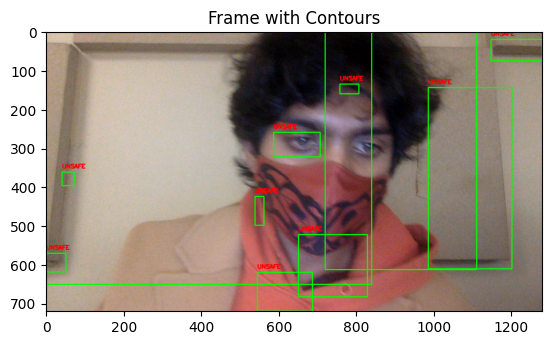

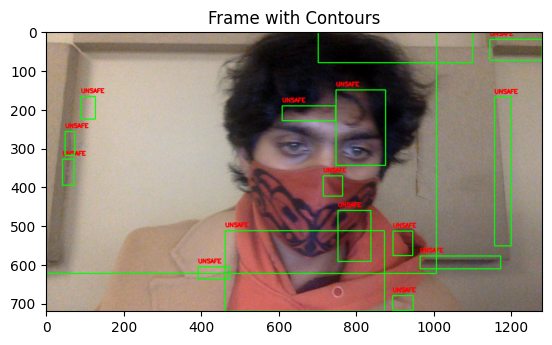

In [56]:
# Assume cap is your VideoCapture object
cap = cv2.VideoCapture(0)

# Check if the camera is opened successfully
if not cap.isOpened():
    print("Error: Couldn't open the webcam.")
else:
    # Read the first frame from the camera
    ret, first_frame = cap.read()

    # Convert the first frame to grayscale
    first_frame_gray = cv2.cvtColor(first_frame, cv2.COLOR_BGR2GRAY)

    # Get the start time
    start_time = time.time()

    # Loop for capturing and processing frames for 10 seconds
    while (time.time() - start_time) < 10:
        # Read the current frame from the camera
        ret, frame = cap.read()

        if not ret:
            print("Error: Couldn't read a frame from the camera.")
            break

        # Convert the current frame to grayscale
        current_frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Compute the absolute difference between the current and first frame
        abs_diff = cv2.absdiff(current_frame_gray, first_frame_gray)

        # Apply Canny edge detector
        edges = cv2.Canny(abs_diff, 30, 100)

        # Apply dilation to enhance edges
        kernel = np.ones((5, 5), np.uint8)
        dilated_edges = cv2.dilate(edges, kernel, iterations=1)

        # Find contours in the dilated edges image
        contours, _ = cv2.findContours(dilated_edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours and fit bounding boxes on the original frame
        frame_with_contours = frame.copy()

        for contour in contours:
            # Check if contour area is large
            if cv2.contourArea(contour) > 500:
                # Fit a bounding box around the contour
                x, y, w, h = cv2.boundingRect(contour)

                # Draw a rectangle around the object
                cv2.rectangle(frame_with_contours, (x, y), (x + w, y + h), (0, 255, 0), 2)

                # Output "UNSAFE" text in red color
                cv2.putText(frame_with_contours, 'UNSAFE', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

        # Display the frame with contours using matplotlib
        plt.imshow(cv2.cvtColor(frame_with_contours, cv2.COLOR_BGR2RGB))
        plt.title('Frame with Contours')
        plt.show()

        # Press 'q' to exit the loop and release the camera
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the camera
    cap.release()

# Close all OpenCV windows
cv2.destroyAllWindows()

## Display images [10 points]

In [36]:
print("I have already displayed the images in privous code")

I have already displayed the images in privous code


## Release objects [5 points]

In [37]:
print("I have already released the objects in every code")

I have already released the objects in every code
